In [32]:
import pandas as pd
df=pd.read_csv("laptops_10.csv")
df.head()

,Company,Product,TypeName,Inches,Cpu,Ram,Gpu,OpSys,Weight,Price_euros,Cpu_Company,Memory_Amount,Memory_Type
0,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 2.3GHz,8GB,Intel Iris Plus Graphics 640,macOS,1.37,1339.69,Intel,128,SSD
1,Apple,Macbook Air,Ultrabook,13.3,Intel Core i5 1.8GHz,8GB,Intel HD Graphics 6000,macOS,1.34,898.94,Intel,128,FlashStorage
2,HP,250 G6,Notebook,15.6,Intel Core i5 7200U 2.5GHz,8GB,Intel HD Graphics 620,No OS,1.86,575.00,Intel,256,SSD
3,Apple,MacBook Pro,Ultrabook,15.4,Intel Core i7 2.7GHz,16GB,AMD Radeon Pro 455,macOS,1.83,2537.45,Intel,512,SSD
4,Apple,MacBook Pro,Ultrabook,13.3,Intel Core i5 3.1GHz,8GB,Intel Iris Plus Graphics 650,macOS,1.37,1803.60,Intel,256,SSD


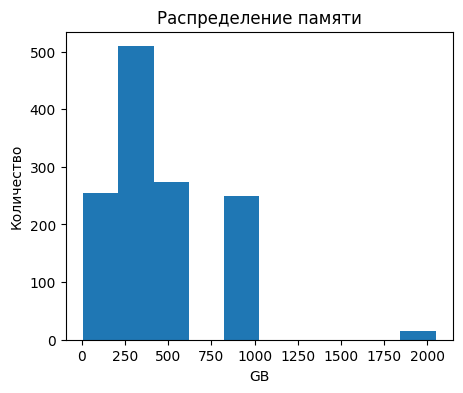

In [33]:
import matplotlib.pyplot as plt

plt.figure(figsize=(5, 4))
plt.hist(df['Memory_Amount'])
plt.title('Распределение памяти')
plt.xlabel('GB')
plt.ylabel('Количество');

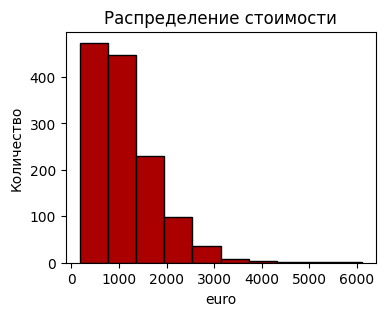

In [34]:
plt.figure(figsize=(4, 3))
plt.hist(df['Price_euros'], color='#AA0000', edgecolor='black')
plt.title('Распределение стоимости')
plt.xlabel('euro')
plt.ylabel('Количество');

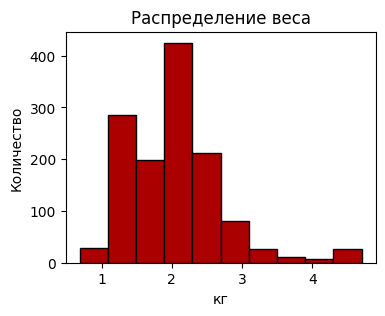

In [35]:
plt.figure(figsize=(4, 3))
plt.hist(df['Weight'], color='#AA0000', edgecolor='black')
plt.title('Распределение веса')
plt.xlabel('кг')
plt.ylabel('Количество');

In [1]:
data = df['Memory_Type'].value_counts()
data
names = data.index
values = data.values
print(names)
print(values)
plt.pie(values, autopct='%.1f%%', labels=names);

NameError: name 'df' is not defined

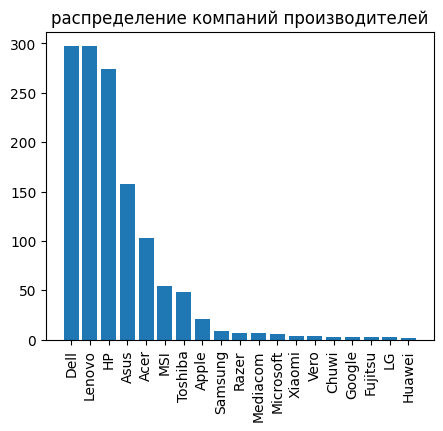

In [37]:
data = df['Company'].value_counts()
data

names = data.index
values = data.values

plt.figure(figsize=(5, 4))
plt.bar(names, values)
plt.title('распределение компаний производителей')
plt.xticks(rotation=90);

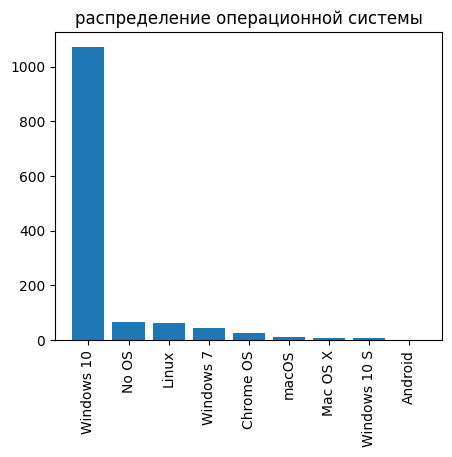

In [38]:
data = df['OpSys'].value_counts()
data

names = data.index
values = data.values

plt.figure(figsize=(5, 4))
plt.bar(names, values)
plt.title('распределение операционной системы')
plt.xticks(rotation=90);

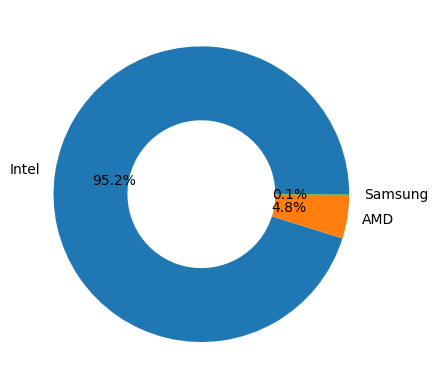

In [39]:
data = df['Cpu_Company'].value_counts()
data
names = data.index
values = data.values
fig, ax = plt.subplots()
ax.pie(values, labels=names, autopct='%.1f%%', wedgeprops=dict(width=0.5));

In [40]:
ax.pie(values, labels=names, autopct='%.1f%%', wedgeprops=dict(width=0.8));


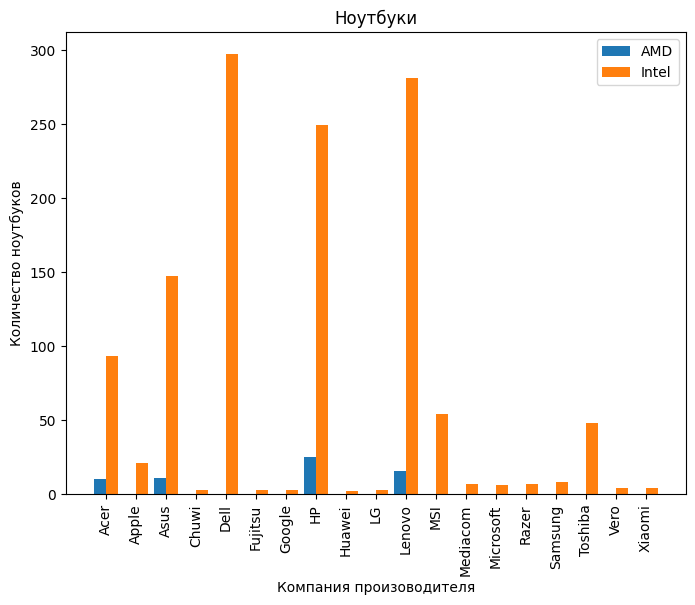

In [41]:
import numpy as np
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'])
data = data.drop(columns=['Samsung']).reset_index()
data
plt.figure(figsize=(8, 6))
n_ticks = np.arange(len(data['AMD']))
offset = 0.2
w = 0.4 

plt.bar(n_ticks - offset, data['AMD'], width=w)
plt.bar(n_ticks + offset, data['Intel'], width=w)
plt.title('Ноутбуки')
plt.xlabel('Компания произоводителя')
plt.ylabel('Количество ноутбуков')
plt.legend(['AMD', 'Intel'])
plt.xticks(n_ticks, data['Company'], rotation=90);

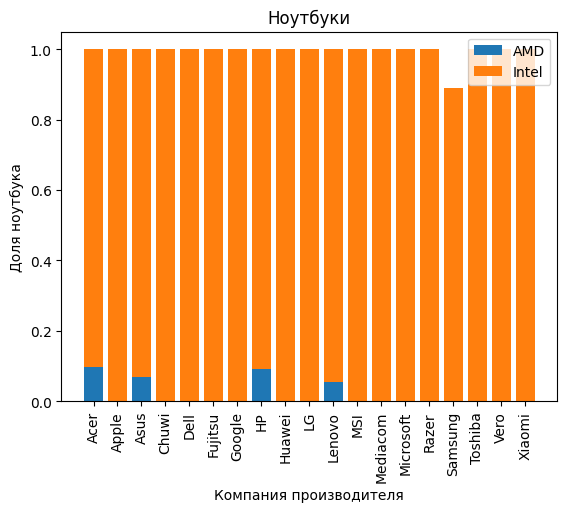

In [42]:
data = pd.crosstab(index=df['Company'], columns=df['Cpu_Company'], normalize='index')
data = data.drop(columns=['Samsung']).reset_index()

plt.bar(data['Company'], data['AMD'])
plt.bar(data['Company'], data['Intel'], bottom=data['AMD'])

plt.title('Ноутбуки')
plt.xlabel('Компания производителя')
plt.ylabel('Доля ноутбука')
plt.legend(['AMD', 'Intel'])
plt.xticks(rotation=90);

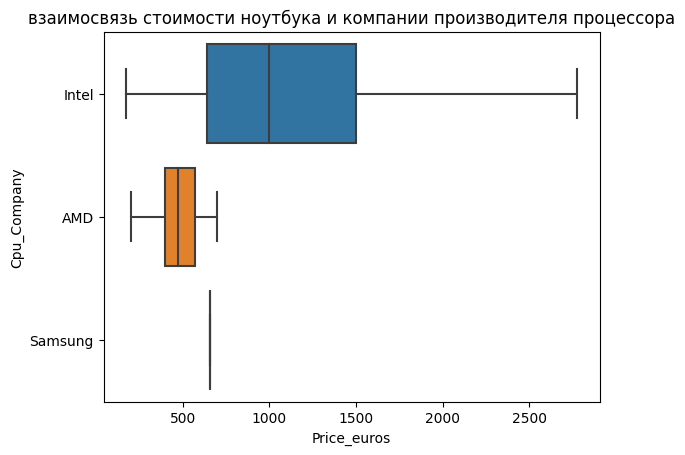

In [43]:
import seaborn as sns

sns.boxplot(x=df['Price_euros'], y=df['Cpu_Company'], showfliers=False)

plt.title('взаимосвязь стоимости ноутбука и компании производителя процессора')
plt.xlabel('Price_euros')
plt.ylabel('Cpu_Company');



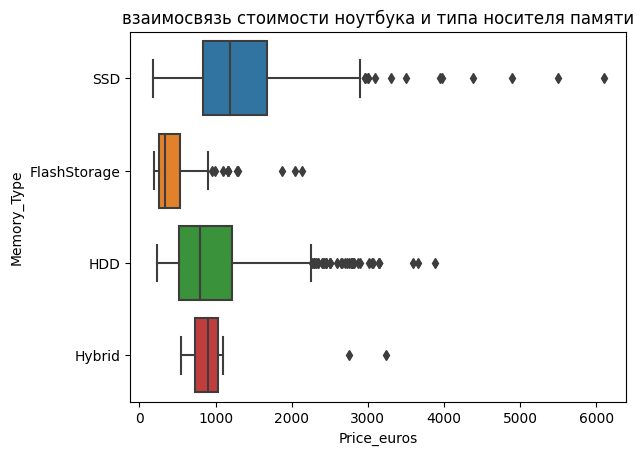

In [44]:
sns.boxplot(x=df['Price_euros'], y=df['Memory_Type'])

plt.title('взаимосвязь стоимости ноутбука и типа носителя памяти')
plt.xlabel('Price_euros')
plt.ylabel('Memory_Type');

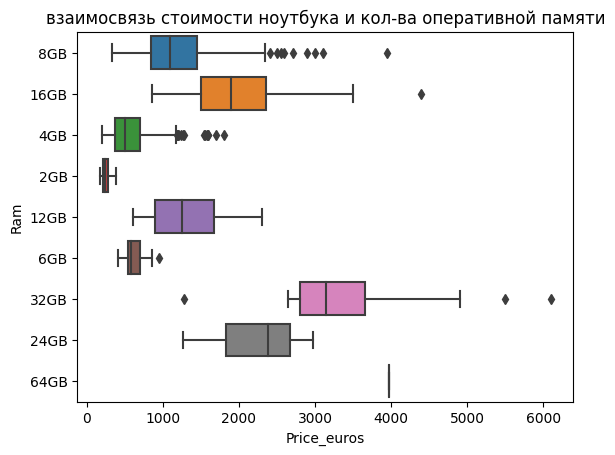

In [45]:
sns.boxplot(x=df['Price_euros'], y=df['Ram'])

plt.title('взаимосвязь стоимости ноутбука и кол-ва оперативной памяти')
plt.xlabel('Price_euros')
plt.ylabel('Ram');

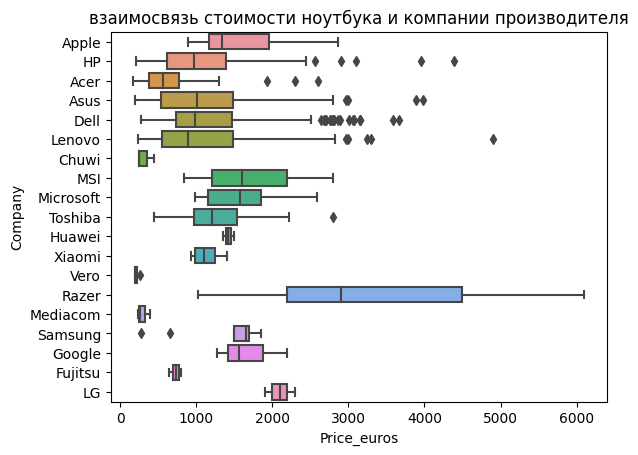

In [46]:
sns.boxplot(x=df['Price_euros'], y=df['Company'])

plt.title('взаимосвязь стоимости ноутбука и компании производителя')
plt.xlabel('Price_euros')
plt.ylabel('Company');

In [47]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix < 0.3)] = 0
corr_matrix
sns.heatmap(corr_matrix, annot=True, linewidths=0.5, cmap='coolwarm');

ValueError: could not convert string to float: 'Apple'

In [ ]:
df = pd.read_csv('kc_house_data.csv' , sep=',')
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix < 0.3)] = 0
corr_matrix
sns.heatmap(corr_matrix, annot=True, linewidths=0.5, cmap='coolwarm');

ValueError: could not convert string to float: '20141013T000000'

In [ ]:
import folium

this_map = folium.Map(prefer_canvs=True)

def plotDot(point):
    folium.CircleMarker(location=[point.lat, point.long], radius=2, popup=[point.price, point.floors]).add_to(this_map)
    
df.apply(plotDot, axis=1)

this_map.fit_bounds(this_map.get_bounds())

this_map